In [1]:
!pip freeze > ../requirements.txt

In [2]:
import os
import sys
sys.path.append(r'..')

import pandas as pd
from scripts.data_analysis import *
from scripts.visualization import *
from scripts.financial_analysis import *
from scripts.data_transformation import *

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\pos.py:25: UserWarning: Module "zipline.assets" not found; multipliers will not be applied to position notionals.
  warnings.warn(
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
datasets_folder = r"../datasets/raw/yfinance_data"
dataset_name = "NVDA_historical_data.csv"
dataset_path = os.path.join(datasets_folder, dataset_name)

df_NVDA = load_data(dataset_path)
# df_NVDA['Date'] = pd.to_datetime(df_NVDA['Date'])
df = clean_stock_data(df_NVDA)
# df, _ = clean_and_preprocess_data(df, date_column="Date")
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits
Date,,,,,,,,,
1999-01-22,1999-01-22,0.043750,0.048828,0.038802,0.041016,0.037621,2714688000,0.0,0.0
1999-01-25,1999-01-25,0.044271,0.045833,0.041016,0.045313,0.041562,510480000,0.0,0.0
1999-01-26,1999-01-26,0.045833,0.046745,0.041146,0.041797,0.038337,343200000,0.0,0.0
1999-01-27,1999-01-27,0.041927,0.042969,0.039583,0.041667,0.038218,244368000,0.0,0.0
1999-01-28,1999-01-28,0.041667,0.041927,0.041276,0.041536,0.038098,227520000,0.0,0.0
...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,119.169998,119.949997,113.440002,114.250000,114.250000,327776900,0.0,0.0
2024-07-25,2024-07-25,113.040001,116.629997,106.300003,112.279999,112.279999,460067000,0.0,0.0
2024-07-26,2024-07-26,116.190002,116.199997,111.580002,113.059998,113.059998,293399100,0.0,0.0


In [4]:
# Summarize the data
summary = summarize_data(df)

# Print the summary in a more presentable format
print("Dataset Summary:")
print(f"Shape: {summary['shape']}")
print("\nMissing Values:")
for column, missing in summary['missing_values'].items():
    print(f"{column}: {missing}")

print("\nDuplicates:")
print(summary['duplicates'])

print("\nUnique Values:")
for column, unique in summary['unique_values'].items():
    print(f"{column}: {unique}")

print("\nColumn Statistics:")
for column, stats in summary['column_stats'].items():
    print(f"\n{column}:")
    for stat, value in stats.items():
        print(f"  {stat}: {value}")

Dataset Summary:
Shape: (6421, 9)

Missing Values:
Date: 0
Open: 0
High: 0
Low: 0
Close: 0
Adj Close: 0
Volume: 0
Dividends: 0
Stock Splits: 0

Duplicates:
0

Unique Values:
Date: 6421
Open: 4867
High: 4840
Low: 4829
Close: 4980
Adj Close: 5380
Volume: 6337
Dividends: 9
Stock Splits: 5

Column Statistics:

Date:
  count: 6421
  mean: 2011-10-25 21:12:15.025697024
  min: 1999-01-22 00:00:00
  25%: 2005-06-10 00:00:00
  50%: 2011-10-24 00:00:00
  75%: 2018-03-13 00:00:00
  max: 2024-07-30 00:00:00
  std: nan

Open:
  count: 6421.0
  mean: 6.207884448327634
  min: 0.0348960012197494
  25%: 0.2775000035762787
  50%: 0.4572499990463257
  75%: 4.182499885559082
  max: 139.8000030517578
  std: 16.13832801651973

High:
  count: 6421.0
  mean: 6.32046639630645
  min: 0.0355469994246959
  25%: 0.2862499952316284
  50%: 0.4647499918937683
  75%: 4.235750198364258
  max: 140.75999450683594
  std: 16.424862099163736

Low:
  count: 6421.0
  mean: 6.0850945864405945
  min: 0.0333329997956752
  25%: 0

In [5]:
indicators = calculate_technical_indicators(df)
multi_value__indicators = calculate_multi_value_indicators(df)
indicators.update(multi_value__indicators)

# [df.__setitem__(indicator, values) for indicator, values in indicators.items()]
for indicator, values in indicators.items():
    df[indicator] = values
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,MACD_Hist,WMA,BB_upper,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist
Date,,,,,,,,,,,,,,,,,,,,,
1999-01-22,1999-01-22,0.043750,0.048828,0.038802,0.041016,0.037621,2714688000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-25,1999-01-25,0.044271,0.045833,0.041016,0.045313,0.041562,510480000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-26,1999-01-26,0.045833,0.046745,0.041146,0.041797,0.038337,343200000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-27,1999-01-27,0.041927,0.042969,0.039583,0.041667,0.038218,244368000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-28,1999-01-28,0.041667,0.041927,0.041276,0.041536,0.038098,227520000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,119.169998,119.949997,113.440002,114.250000,114.250000,327776900,0.0,0.0,124.9165,...,-1.886885,123.829667,134.369831,124.9165,115.463170,5.614639,26.660837,-164.609264,-15.313915,-1.886885
2024-07-25,2024-07-25,113.040001,116.629997,106.300003,112.279999,112.279999,460067000,0.0,0.0,124.2105,...,-2.157637,122.626191,135.113151,124.2105,113.307849,5.951450,27.287931,-194.829468,-11.868134,-2.157637
2024-07-26,2024-07-26,116.190002,116.199997,111.580002,113.059998,113.059998,293399100,0.0,0.0,123.6640,...,-2.176669,121.564238,135.602600,123.6640,111.725400,5.856346,27.870231,-140.207958,-12.519349,-2.176669


# Plotting indicators

In [6]:
plot_indicators(data=df, indicators=['RSI', 'MACD', 'MACD_Signal'], title='Technical Indicators')

In [7]:
plot_indicators(data=df, indicators=['SMA', 'RSI', 'EMA', 'MACD', 'MACD_Signal', 'WMA', 'BB_upper', 'BB_middle', 'BB_lower', 'ATR', 'ADX', 'CCI', 'ROC'], title='Technical Indicators')

In [8]:
plot_indicators(data=df, indicators=['SMA', 'EMA'], title='Simple Moving Average (SMA) vs Exponential Moving Average (EMA)')

In [9]:
plot_indicators(data=df, indicators=['RSI', 'ADX'], title='Relative Strength Index (RSI) vs Average Directional Index (ADX)')

In [10]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower'], title='Bollinger Bands')

In [11]:
plot_indicators(data=df, indicators=['ATR', 'CCI'], title='Average True Range (ATR) vs Commodity Channel Index (CCI)')

In [12]:
plot_indicators(data=df, indicators=['ROC', 'MACD_hist'], title='Rate of Change (ROC) vs MACD Histogram')

In [13]:
plot_indicators(data=df, indicators = ['MACD', 'MACD_Signal'], title = 'Moving Average Convergence Divergence (MACD)')

In [14]:
plot_indicators(data=df, indicators=['SMA', 'WMA'], title='Simple Moving Average (SMA) vs Weighted Moving Average (WMA)')

In [15]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [16]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [17]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [18]:
plot_indicators(data=df, indicators=['CCI', 'Close'], title='Commodity Channel Index (CCI) with Close Price')

In [19]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

In [20]:
plot_indicators(data=df, indicators=['SMA', 'EMA', 'WMA'], title='Moving Averages (SMA, EMA, WMA)')

In [21]:
plot_indicators(data=df, indicators=['RSI', 'CCI'], title='Relative Strength Index (RSI) vs Commodity Channel Index (CCI)')

In [22]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [23]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [24]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [25]:
plot_indicators(data=df, indicators=['ADX', 'Close'], title='Average Directional Index (ADX) with Close Price')

In [26]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

# Additional

In [27]:
plot_interactive_stock_chart(df, 'Open')

In [28]:
plot_stock_data(df)

In [29]:
plot_stock_data_2(df)

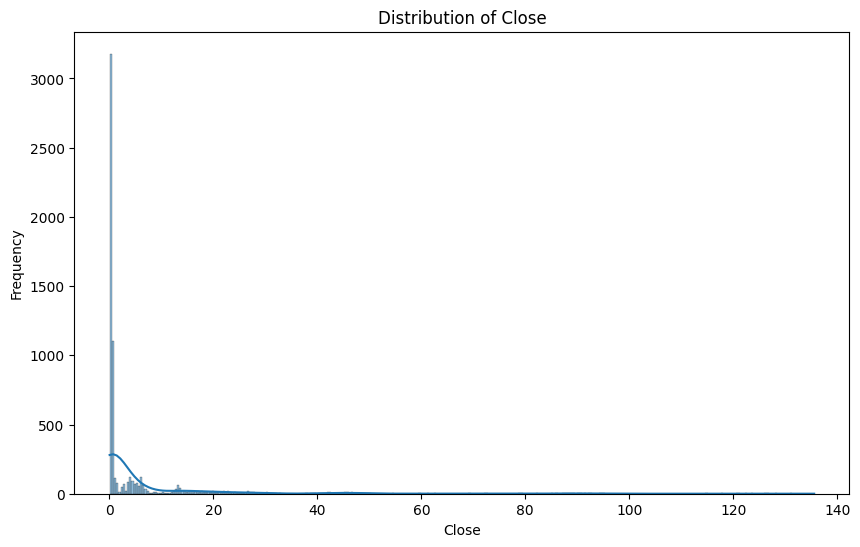

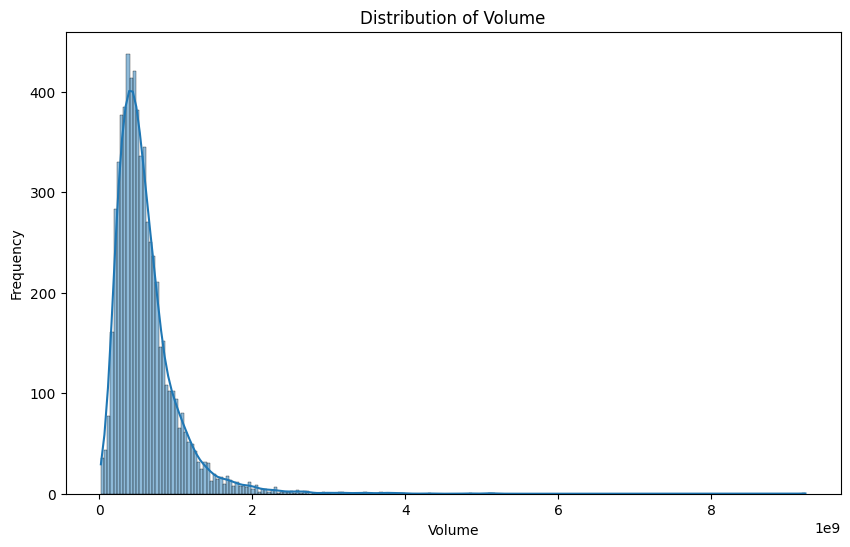

In [30]:
# Plot distributions
plot_distributions(df)

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\plotting.py:670: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '-6.239%' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Start date,1999-01-22
End date,2024-07-30
Total months,305
,Backtest
Annual return,-6.239%
Cumulative returns,-80.633%
Annual volatility,23.264%
Sharpe ratio,-0.16
Calmar ratio,-0.07
Stability,0.86
Max drawdown,-87.632%


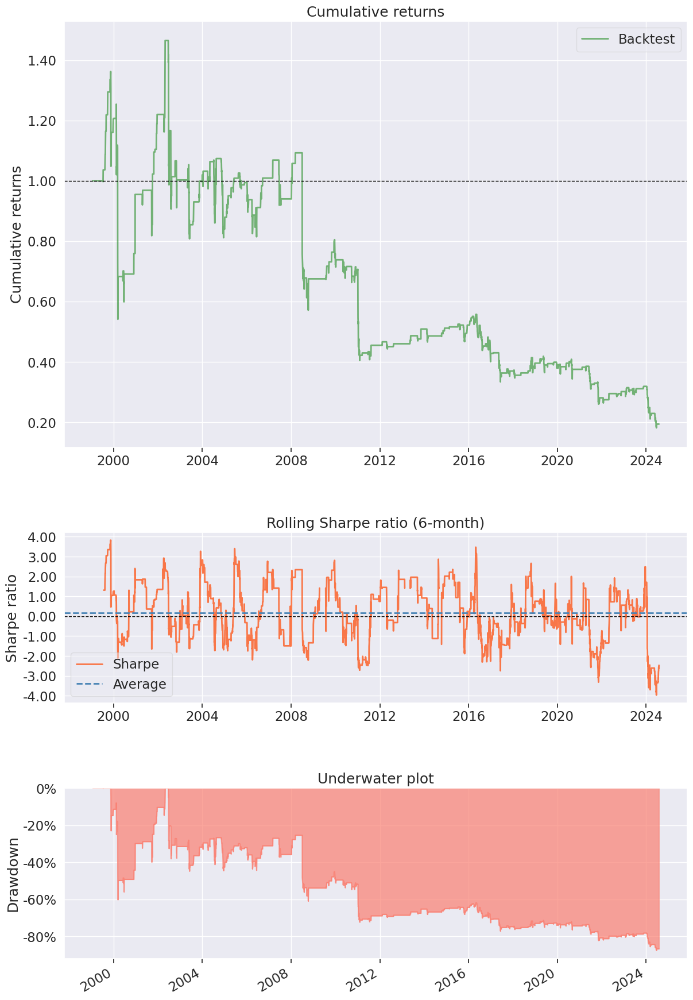

In [31]:
df['Signal'] = generate_signals(df)
df['Daily_Return'] = calculate_daily_return(df)
df['Strategy_Return'] = calculate_strategy_return(df)

create_performance_tear_sheet(df['Strategy_Return'])

In [32]:
# Calculate correlations
correlations = calculate_correlations(df, method="pearson")
correlations

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,1.000000,0.544225,0.544354,0.545045,0.544852,0.544615,-0.267813,0.085110,0.015590,0.549709,...,0.549709,0.549870,0.530263,0.057784,0.083389,0.009680,-0.003897,-0.117529,0.002418,-0.015172
Open,0.544225,1.000000,0.999890,0.999800,0.999613,0.999613,-0.121492,0.067563,0.077865,0.996886,...,0.996886,0.992206,0.977988,0.159208,0.067006,0.063194,-0.052408,-0.133017,0.010601,-0.023161
High,0.544354,0.999890,1.000000,0.999827,0.999801,0.999801,-0.120641,0.067146,0.078196,0.996858,...,0.996858,0.992087,0.978541,0.159637,0.067611,0.063910,-0.051495,-0.133642,0.013595,-0.024320
Low,0.545045,0.999800,0.999827,1.000000,0.999871,0.999871,-0.122766,0.067386,0.077245,0.996642,...,0.996642,0.992051,0.976687,0.158737,0.069233,0.064843,-0.048670,-0.134328,0.014167,-0.024860
Close,0.544852,0.999613,0.999801,0.999871,1.000000,1.000000,-0.121819,0.067231,0.078886,0.996487,...,0.996487,0.991734,0.977213,0.159050,0.069504,0.065561,-0.046981,-0.135041,0.017505,-0.025954
Adj Close,0.544615,0.999613,0.999801,0.999871,1.000000,1.000000,-0.121855,0.067223,0.078875,0.996487,...,0.996487,0.991733,0.977214,0.159046,0.069421,0.065530,-0.046995,-0.134973,0.017493,-0.025943
Volume,-0.267813,-0.121492,-0.120641,-0.122766,-0.121819,-0.121855,1.000000,-0.037259,-0.003094,-0.125075,...,-0.125075,-0.128241,-0.103876,0.172501,-0.014948,0.036069,0.018479,0.010957,0.057380,-0.071487
Dividends,0.085110,0.067563,0.067146,0.067386,0.067231,0.067223,-0.037259,1.000000,-0.001899,0.064159,...,0.064159,0.059023,0.065119,0.028968,0.015572,0.018279,0.033355,-0.029855,-0.000384,0.001270
Stock Splits,0.015590,0.077865,0.078196,0.077245,0.078886,0.078875,-0.003094,-0.001899,1.000000,0.071614,...,0.071614,0.062835,0.073541,0.018096,0.001434,0.009656,0.072403,-0.031070,-0.009141,-0.004946
SMA,0.549709,0.996886,0.996858,0.996642,0.996487,0.996487,-0.125075,0.064159,0.071614,1.000000,...,1.000000,0.998242,0.983015,0.149976,0.043827,0.042019,-0.121000,-0.112667,0.007088,-0.020390


In [33]:
# Detect outliers
outliers = detect_outliers(df, column="Close", method="iqr")
outliers

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,,,,,,,,,,,,,,,,,,,,,
2020-07-08,2020-07-08,9.993750,10.225000,9.965500,10.216000,10.185654,365480000,0.0,0.0,9.383862,...,9.383862,8.731801,0.310267,24.944896,209.259814,8.105818,0.039099,-1,0.034872,0.000000
2020-07-09,2020-07-09,10.380250,10.570000,10.233500,10.509000,10.477784,494548000,0.0,0.0,9.440975,...,9.440975,8.625337,0.313391,26.790713,225.852947,13.789177,0.069027,-1,0.028681,-0.028681
2020-07-10,2020-07-10,10.588750,10.655250,10.378750,10.479250,10.448119,497676000,0.0,0.0,9.525125,...,9.525125,8.647965,0.310756,28.645156,194.112876,10.424133,0.079397,-1,-0.002831,0.002831
2020-07-13,2020-07-13,10.595000,10.792250,10.025000,10.052250,10.022389,457076000,0.0,0.0,9.581112,...,9.581112,8.719601,0.343363,28.713967,127.610067,9.800658,0.051434,0,-0.040747,0.040747
2020-07-14,2020-07-14,10.075000,10.402750,9.785500,10.377000,10.346177,542676000,0.0,0.0,9.641275,...,9.641275,8.735062,0.362926,27.856888,95.315605,12.793479,0.048766,0,0.032306,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,119.169998,119.949997,113.440002,114.250000,114.250000,327776900,0.0,0.0,124.916500,...,124.916500,115.463170,5.614639,26.660837,-164.609264,-15.313915,-1.886885,0,-0.068032,-0.000000
2024-07-25,2024-07-25,113.040001,116.629997,106.300003,112.279999,112.279999,460067000,0.0,0.0,124.210500,...,124.210500,113.307849,5.951450,27.287931,-194.829468,-11.868134,-2.157637,0,-0.017243,-0.000000
2024-07-26,2024-07-26,116.190002,116.199997,111.580002,113.059998,113.059998,293399100,0.0,0.0,123.664000,...,123.664000,111.725400,5.856346,27.870231,-140.207958,-12.519349,-2.176669,0,0.006947,0.000000


In [34]:
# Time-based aggregation
time_based_aggregation(df, time_column="Date", agg_column="Close", freq="ME", agg_func="mean")

,Date,Close
0,1999-01-31,0.041819
1,1999-02-28,0.042160
2,1999-03-31,0.043218
3,1999-04-30,0.039794
4,1999-05-31,0.037204
...,...,...
302,2024-03-31,89.442550
303,2024-04-30,85.703909
304,2024-05-31,96.220182
305,2024-06-30,124.589105
